In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter("ignore")

from datetime import datetime
from sklearn.preprocessing import MinMaxScaler

In [6]:
path = '../data/CM7/3월/20230311~20230320_CM7.xlsx'
all_df = pd.read_excel(path)

AI 데이터 분석을 위한 공정은 아래와 같습니다.

        1. 사이클타임 : COM_PV_ALT

        2. 작업수량 : COM_PV_CC

        3. 보온로 압력 : COM_PV_FP

        4. 용탕온도 : COM_PV_FT

        5. 공압센서 : CAST_OUT_ACTION_TO_PQ_VAL

In [7]:
set(all_df['cnt_name'])

{'CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.CAST_OUT_ACTION_TO_PQ_VAL',
 'CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_ALT',
 'CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_CC',
 'CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP',
 'CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FT'}

In [8]:
all_df.info() # NULL 값 X

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 905140 entries, 0 to 905139
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   idx       905140 non-null  int64  
 1   ae_name   905140 non-null  object 
 2   cnt_name  905140 non-null  object 
 3   cnt_data  905140 non-null  float64
 4   cnt_time  905140 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 34.5+ MB


# 보온로 압력

In [5]:
FP_df = all_df[all_df['cnt_name']=='CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP']

# UNIX 시간 복원
FP_df['cnt_time'] = FP_df['cnt_time'].apply(lambda x: datetime.utcfromtimestamp(int(x)//1000))
FP_df.head(10)

,idx,ae_name,cnt_name,cnt_data,cnt_time
31,3309,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,2.0,2023-03-10 15:00:31
33,3503,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,0.0,2023-03-10 15:00:33
37,3746,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,31.0,2023-03-10 15:00:35
39,4017,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,329.0,2023-03-10 15:00:37
41,4166,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,613.0,2023-03-10 15:00:39
44,4326,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,814.0,2023-03-10 15:00:40
45,4430,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,815.0,2023-03-10 15:00:41
49,4593,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,814.0,2023-03-10 15:00:42
52,4745,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,857.0,2023-03-10 15:00:43
54,4940,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FP,892.0,2023-03-10 15:00:45


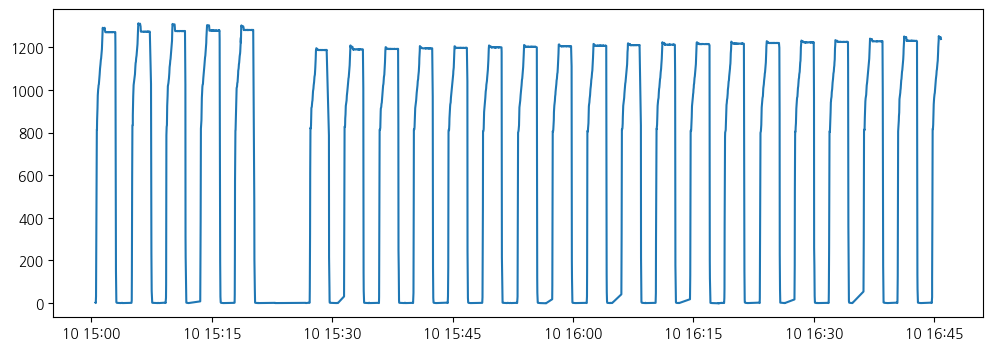

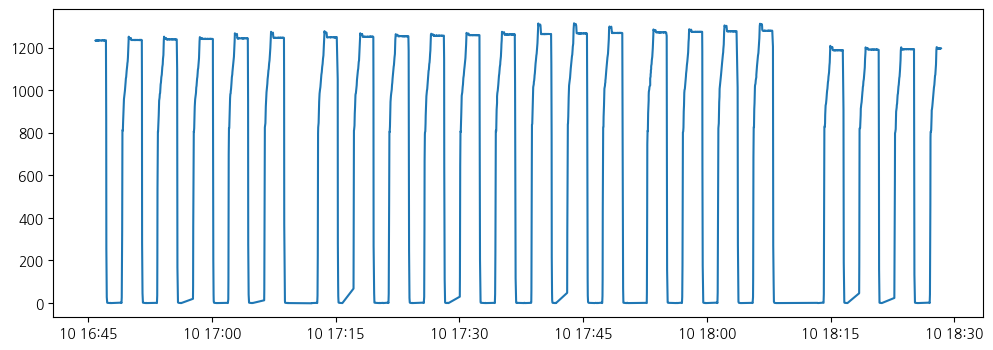

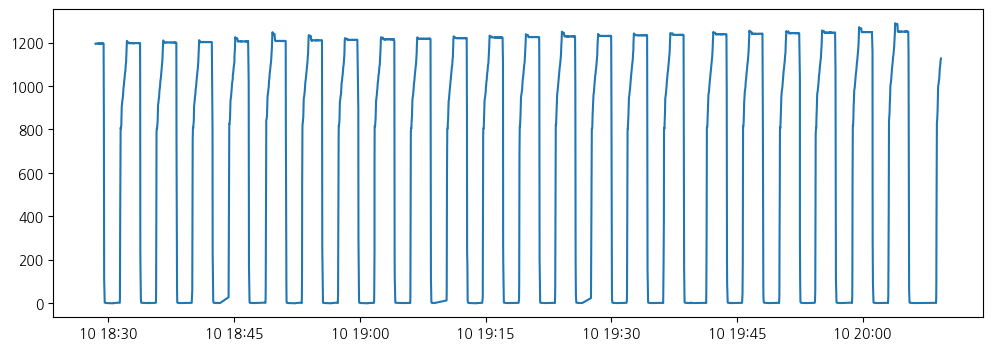

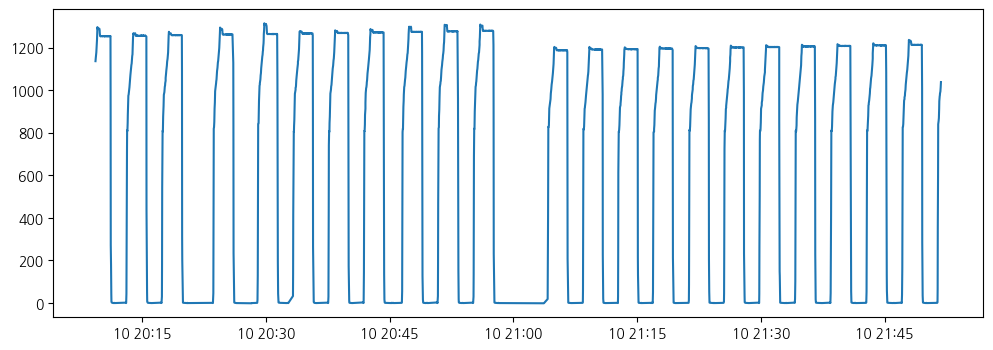

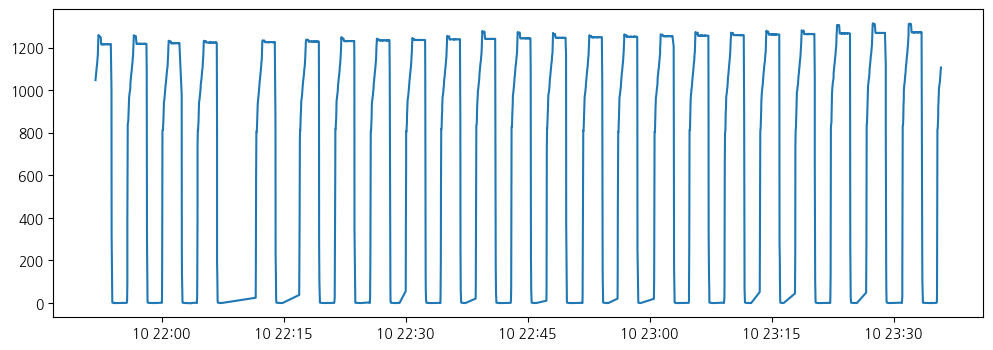

...

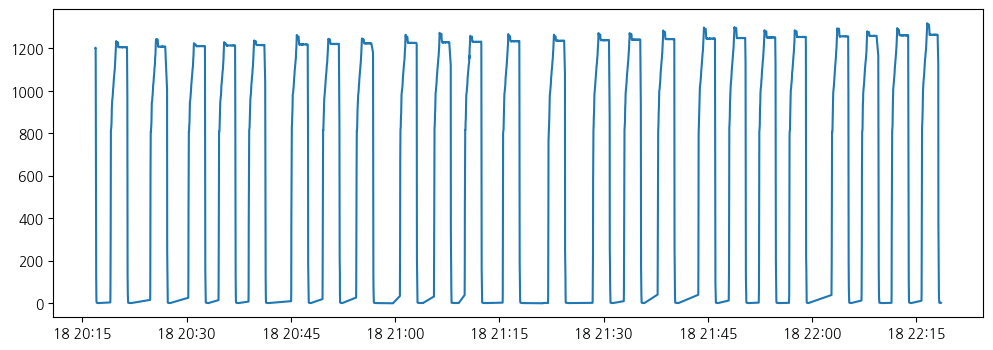

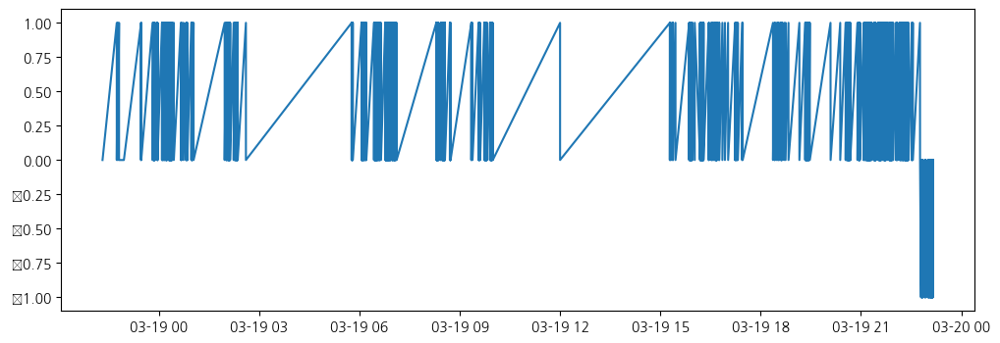

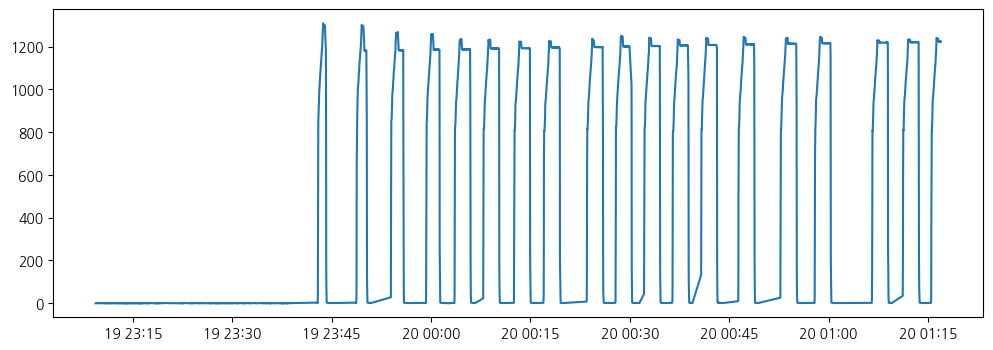

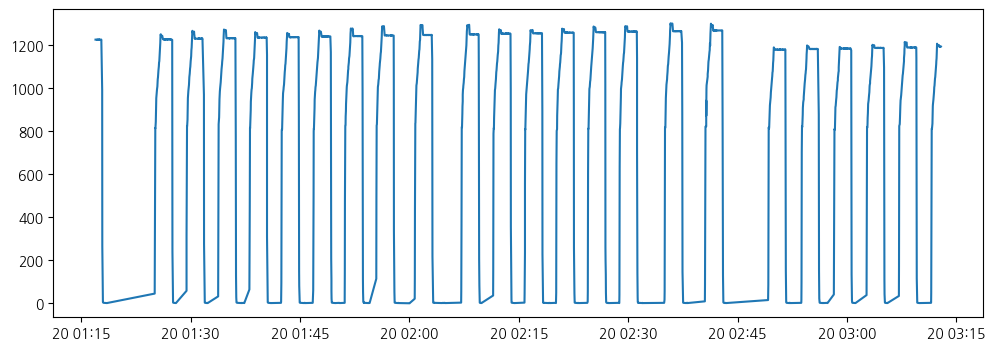

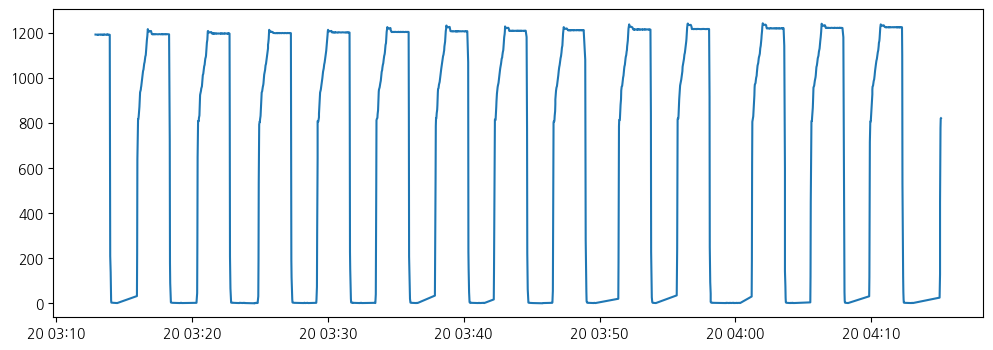

In [6]:
i = 0
size = 2000 # window size

while i*size < len(FP_df):
    plt.figure(figsize=(12,4))
    plt.plot(FP_df[i*size:(i+1)*size]['cnt_time'], FP_df[i*size:(i+1)*size]['cnt_data'])    
    
    i+=1 

# 공압센서

In [7]:
P_df = all_df[all_df['cnt_name']=='CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.CAST_OUT_ACTION_TO_PQ_VAL']

# UNIX 시간 복원
P_df['cnt_time'] = P_df['cnt_time'].apply(lambda x: datetime.utcfromtimestamp(int(x)//1000))
P_df.head(3)

,idx,ae_name,cnt_name,cnt_data,cnt_time
35,3728,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.CAST_OUT_...,-3121.0,2023-03-10 15:00:35
46,4414,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.CAST_OUT_...,0.0,2023-03-10 15:00:41
53,4744,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.CAST_OUT_...,22886.0,2023-03-10 15:00:43


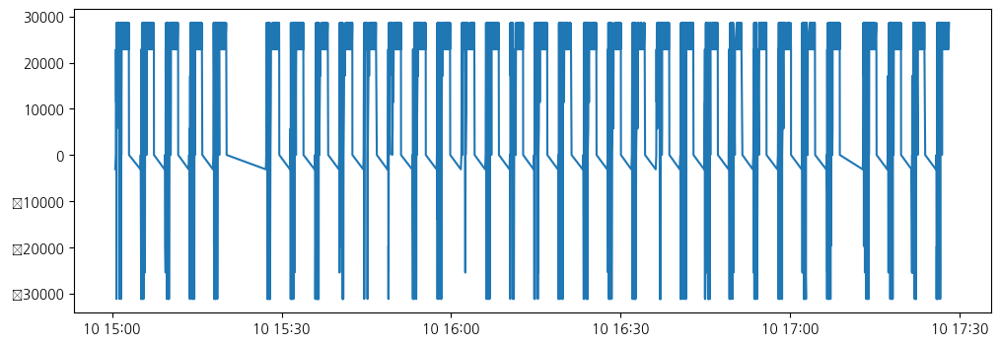

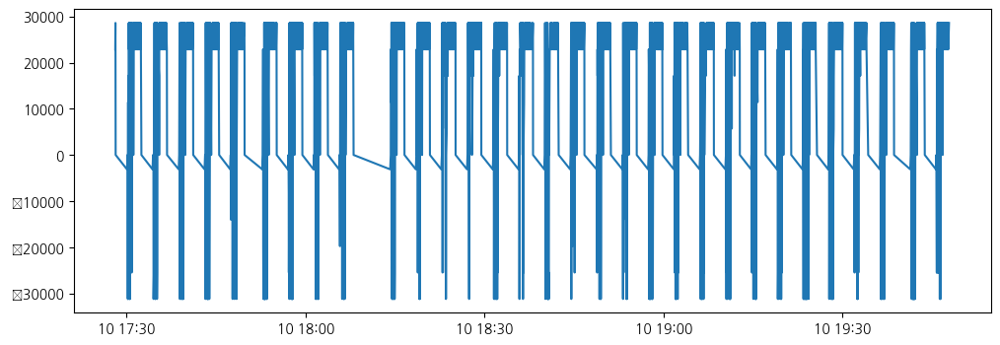

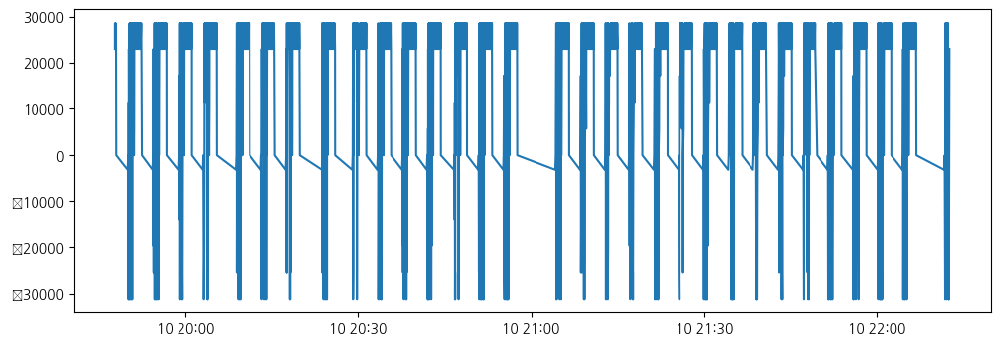

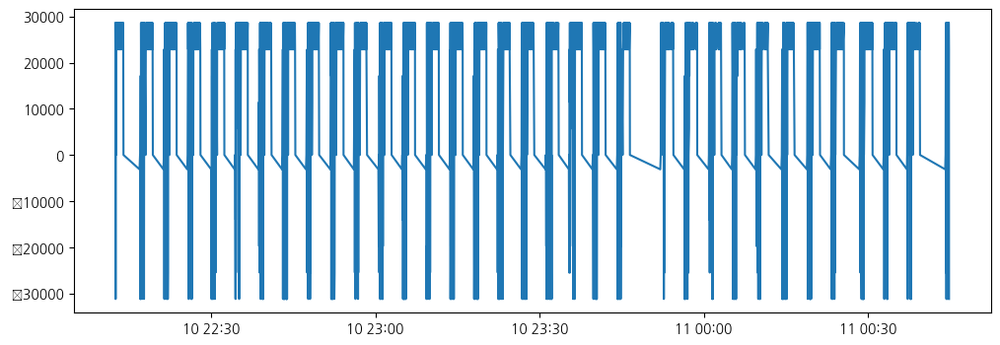

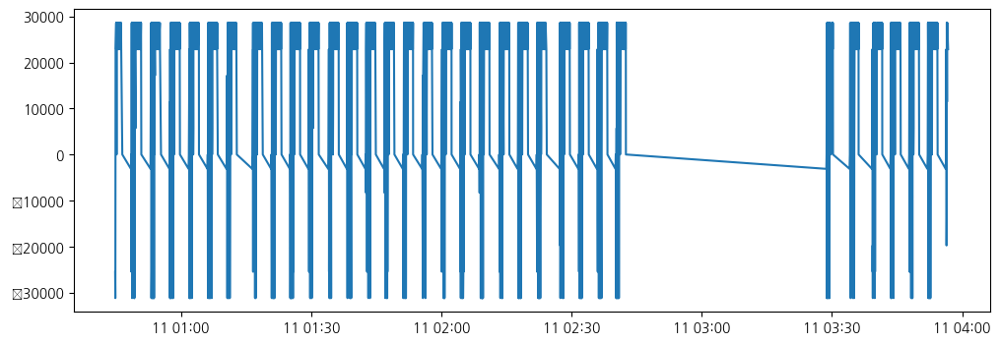

...

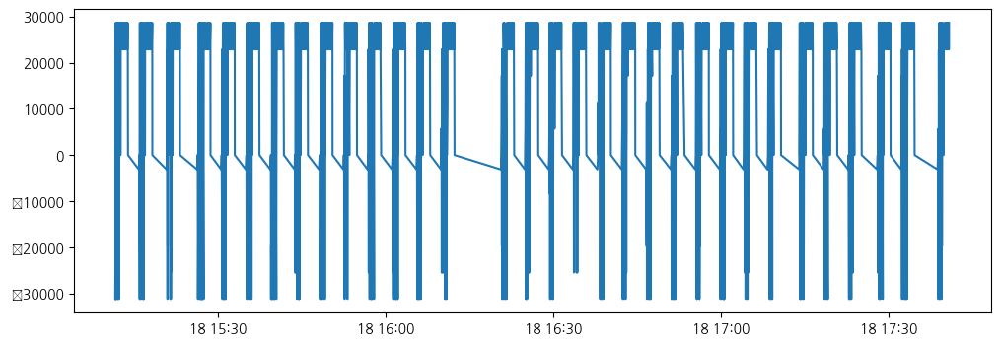

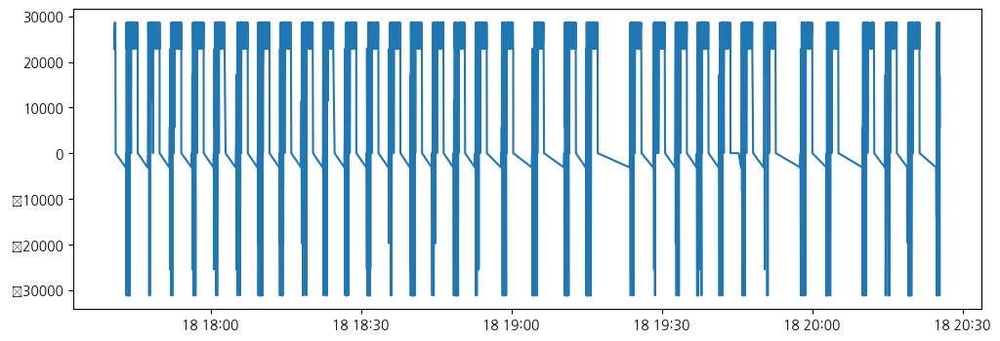

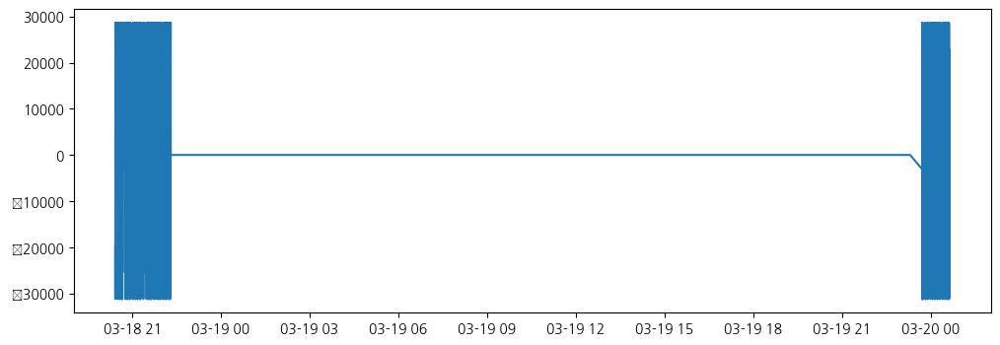

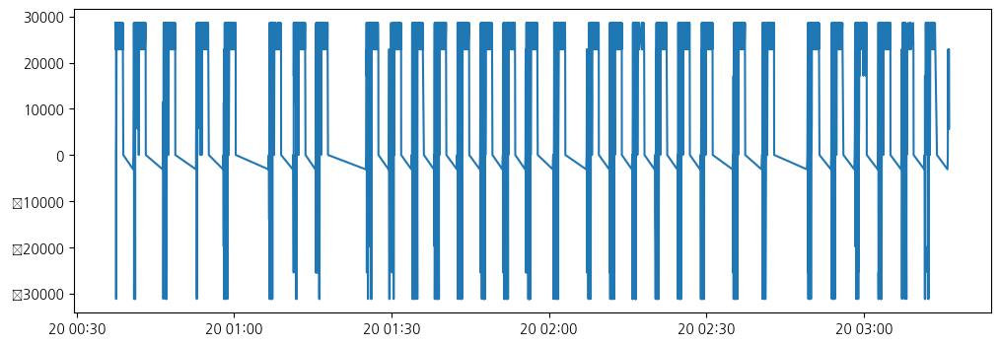

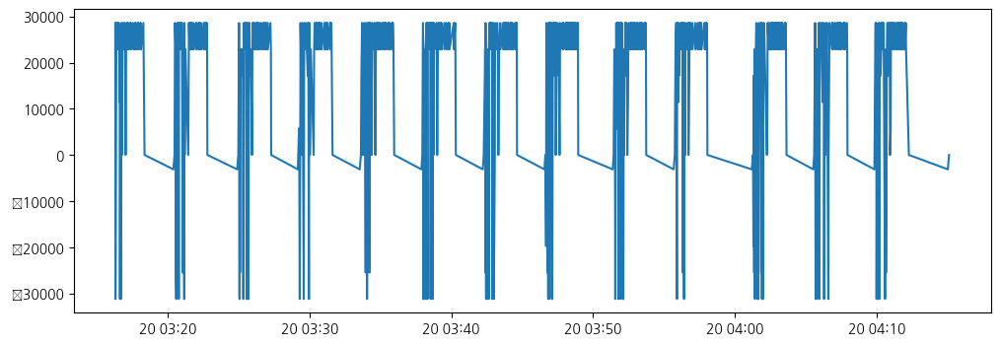

In [8]:
i = 0
size = 2000 # window size

while i*size < len(P_df):
    plt.figure(figsize=(12,4))
    plt.plot(P_df[i*size:(i+1)*size]['cnt_time'], P_df[i*size:(i+1)*size]['cnt_data'])    
    
    i+=1    

# 용탕온도

In [9]:
T_df = all_df[all_df['cnt_name']=='CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FT']

# UNIX 시간 복원
T_df['cnt_time'] = T_df['cnt_time'].apply(lambda x: datetime.utcfromtimestamp(int(x)//1000))
T_df.head(3)

,idx,ae_name,cnt_name,cnt_data,cnt_time
1,114,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FT,734.0,2023-03-10 15:00:01
4,447,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FT,733.9,2023-03-10 15:00:04
7,672,PLC_CPC_LineB,CPC_LineB.CPC_PLCB.Global.CM7_DATA_x.COM_PV_FT,733.7,2023-03-10 15:00:06


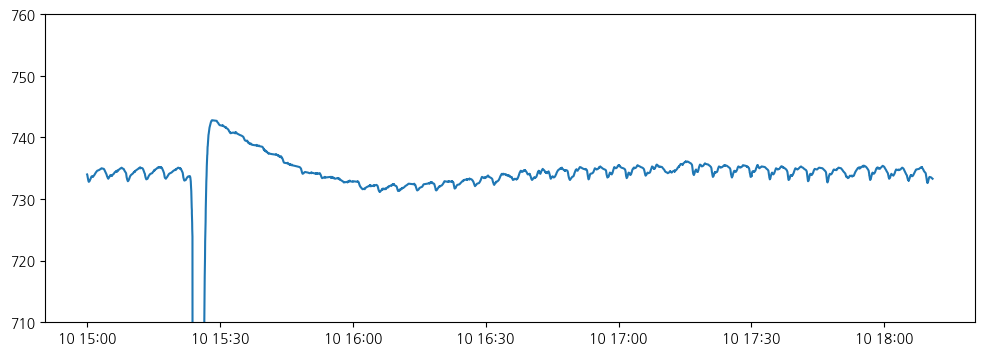

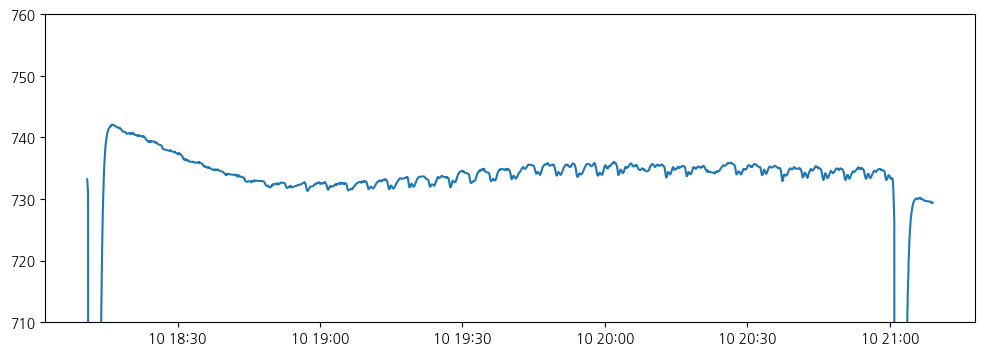

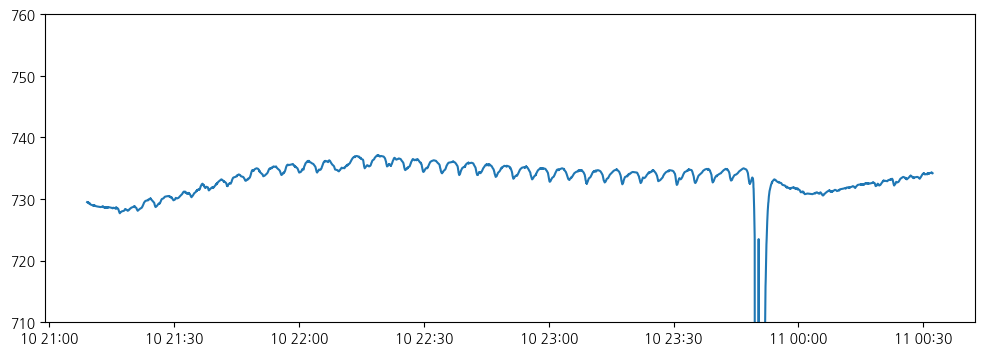

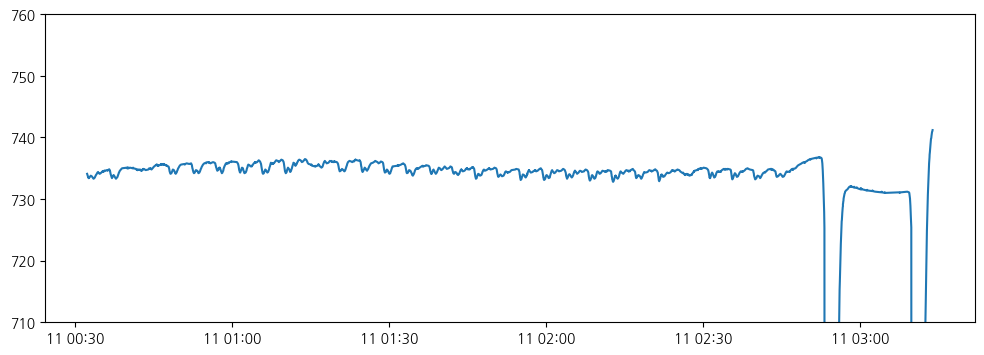

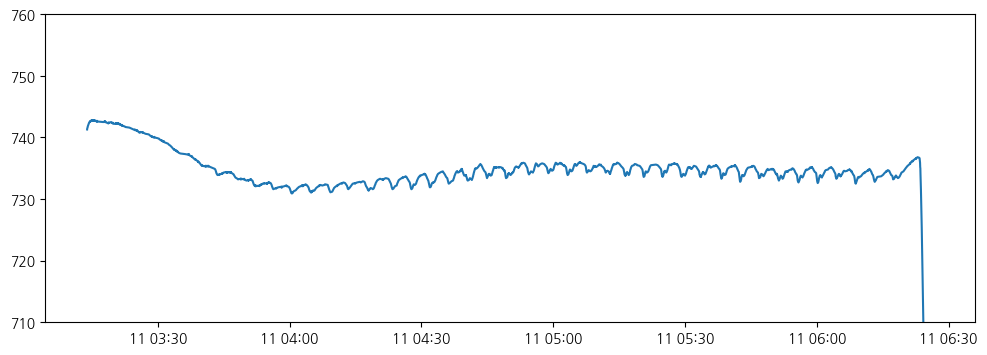

...

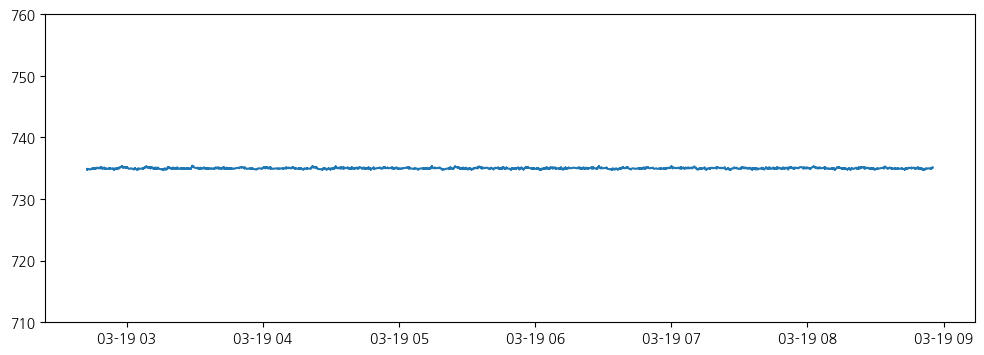

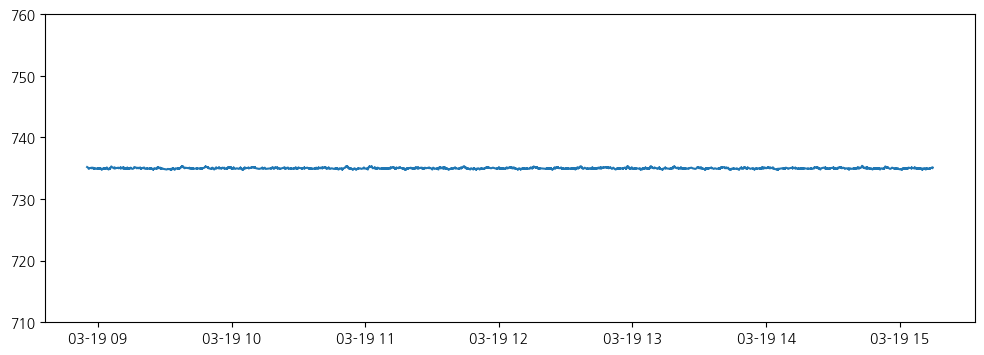

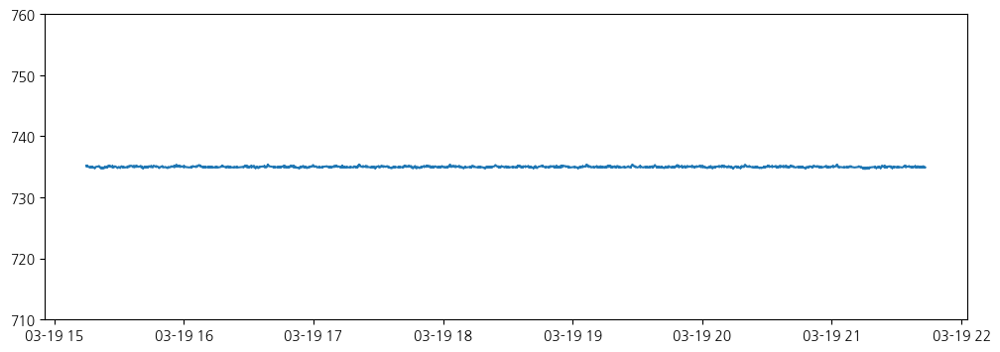

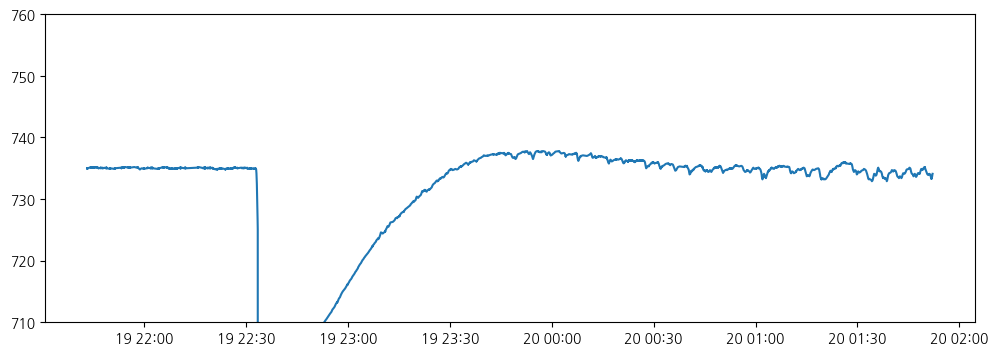

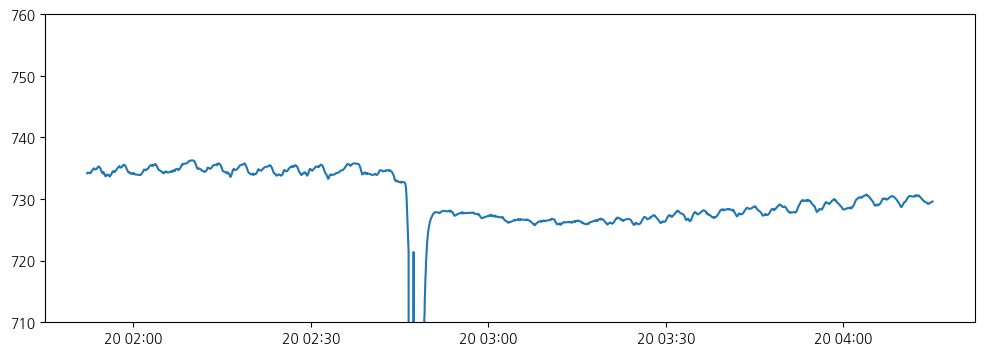

In [10]:
i = 0
size = 2000 # window size

while i*size < len(T_df):
    plt.figure(figsize=(12,4))
    plt.plot(T_df[i*size:(i+1)*size]['cnt_time'], T_df[i*size:(i+1)*size]['cnt_data'])  
    plt.ylim([710,760])
    
    i+=1    

# 정규화 후 확인

In [11]:
scaler = MinMaxScaler()

In [65]:
normalized_FP = FP_df.copy() # 보온로 압력
normalized_P = P_df.copy() # 공압 센서
normalized_T = T_df.copy() # 용탕 온도


numerical = ['cnt_data']
normalized_FP[numerical] = scaler.fit_transform(normalized_FP[numerical])
normalized_P[numerical] = scaler.fit_transform(normalized_P[numerical])
normalized_T[numerical] = scaler.fit_transform(normalized_T[numerical])


df_list = [normalized_FP, normalized_P, normalized_T]
df_dict = {'보온로 압력':('blue', normalized_FP), '공압 센서': ('gold', normalized_P), '용탕 온도':('red', normalized_T)}

In [66]:
window_size = [len(df)//100 for df in df_list] # 10일 데이터 / 120 => 2시간
window_size

[1992, 1368, 1294]

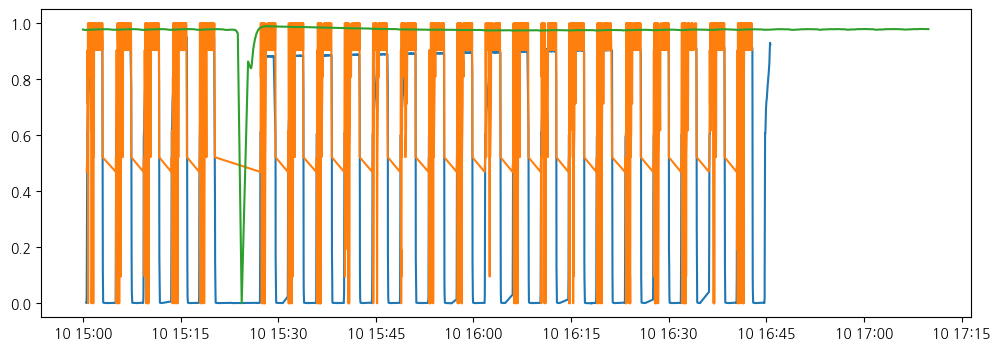

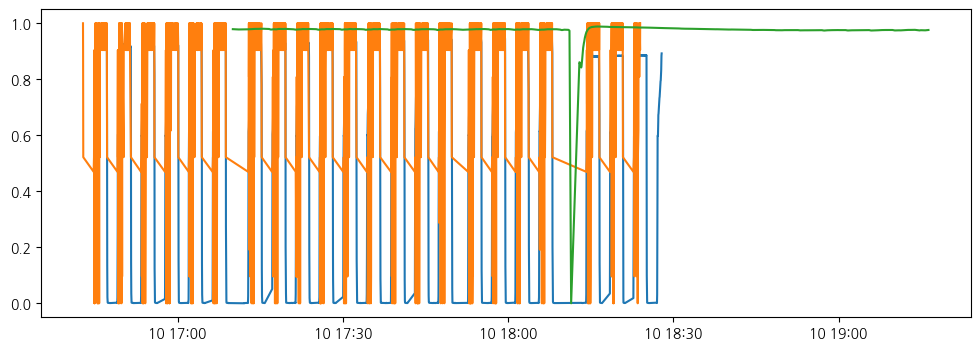

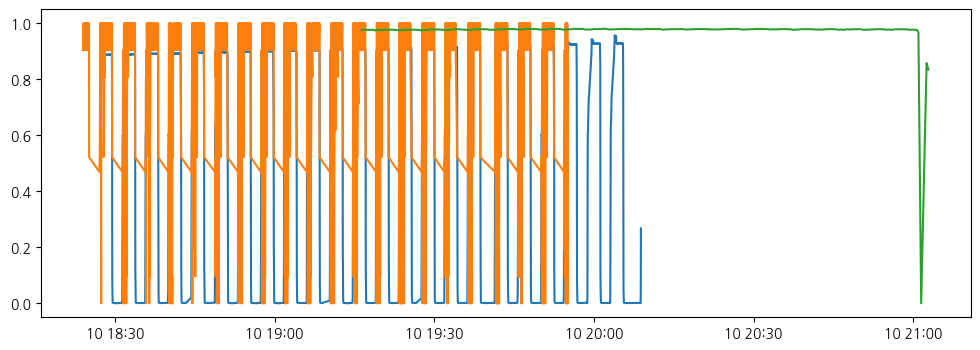

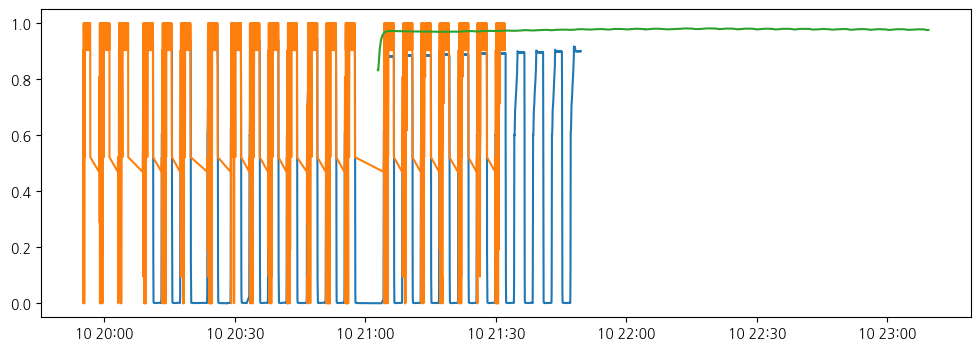

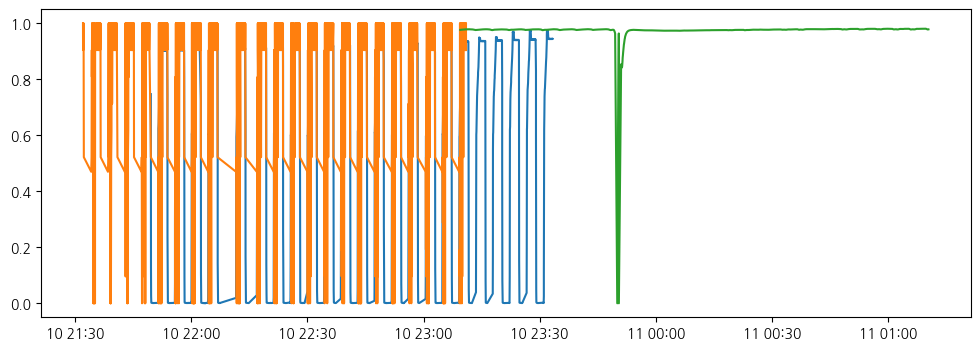

...

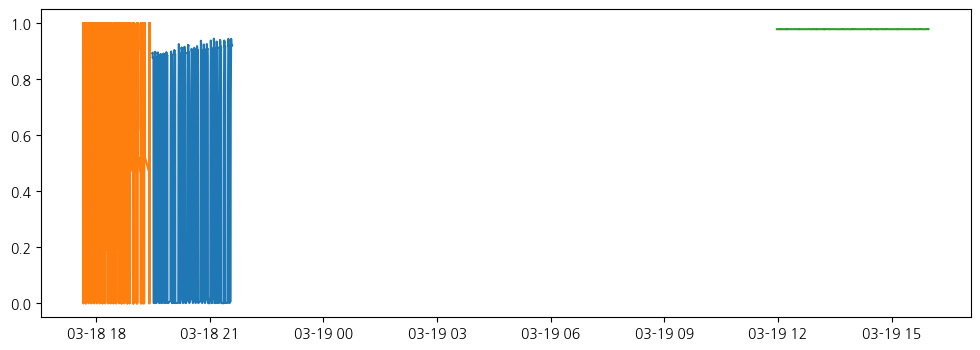

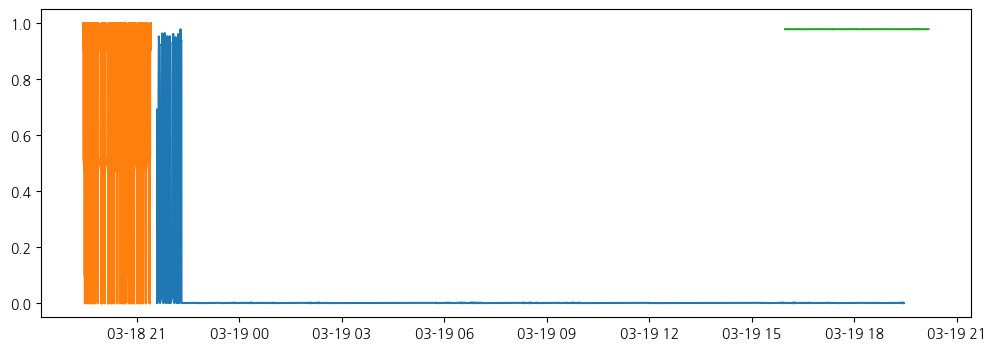

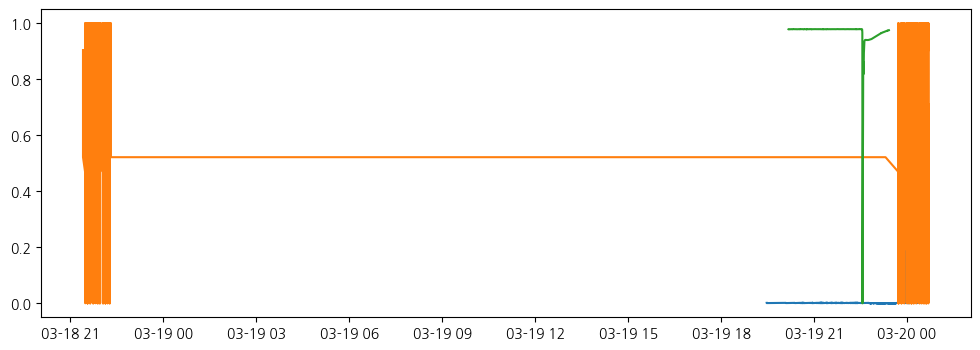

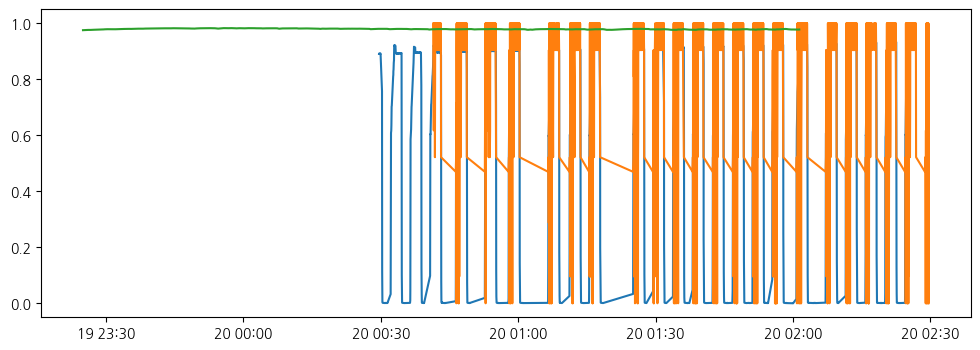

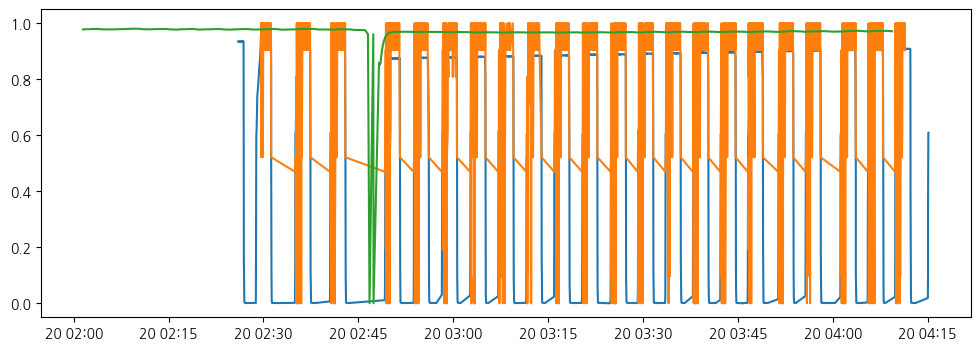

In [67]:
i = 0
while i * window_size[0] < len(df_list[0]):
    plt.figure(figsize=(12,4))
    
    for j in range(3):
        size = window_size[j]
        plt.plot(df_list[j][i*size:(i+1)*size]['cnt_time'], df_list[j][i*size:(i+1)*size]['cnt_data'])    
        
    i += 1

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

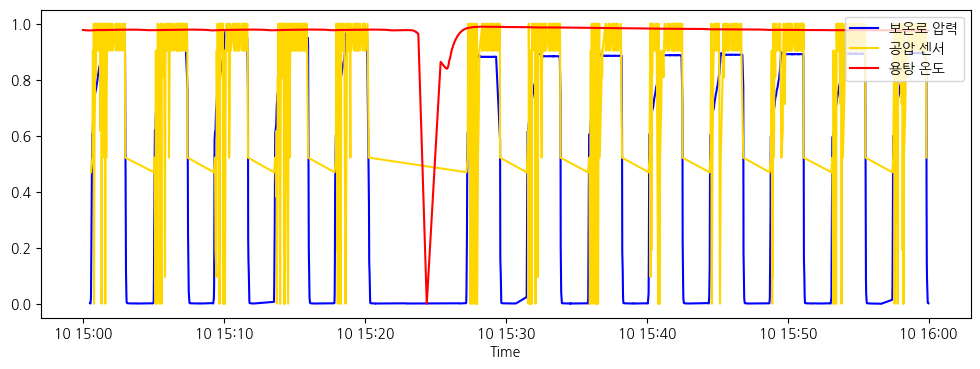

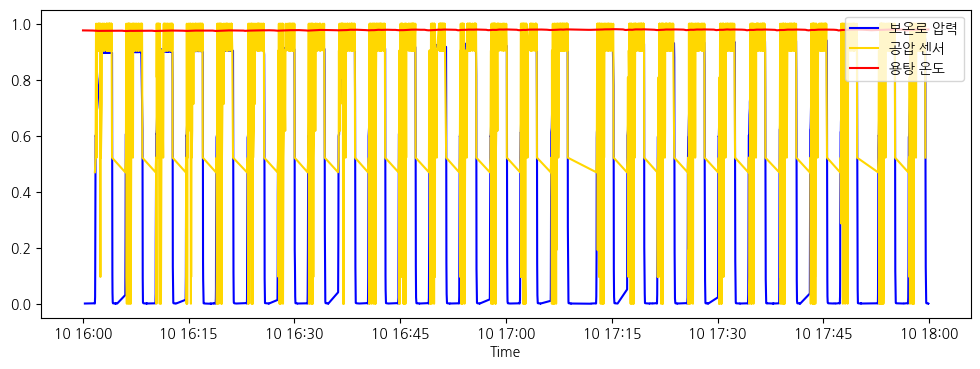

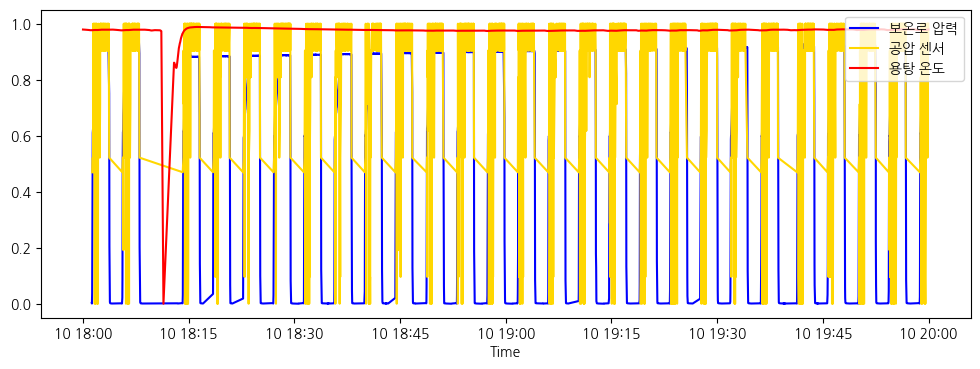

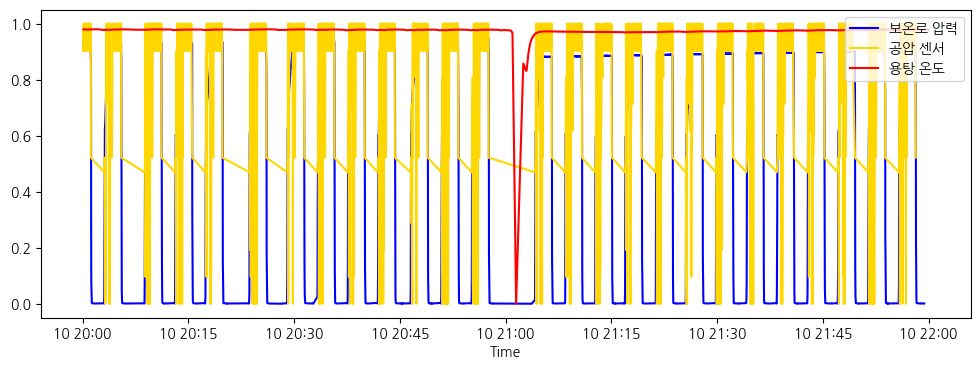

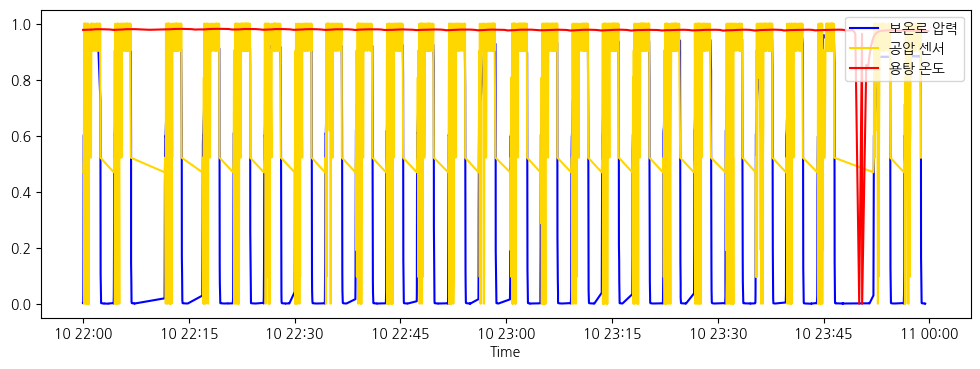

...

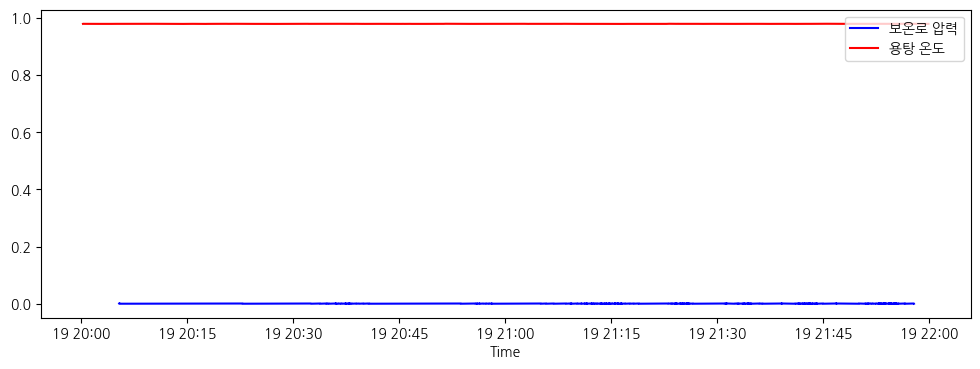

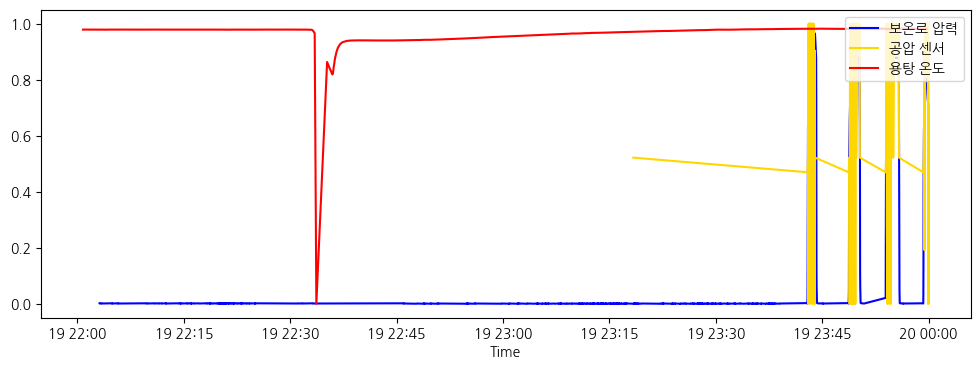

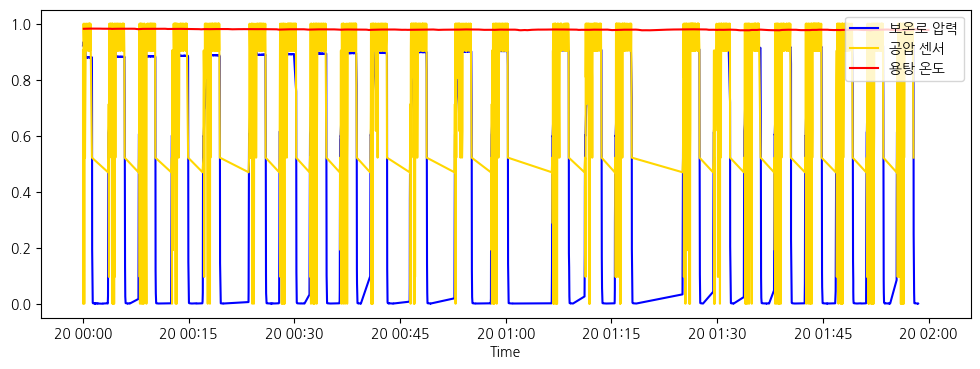

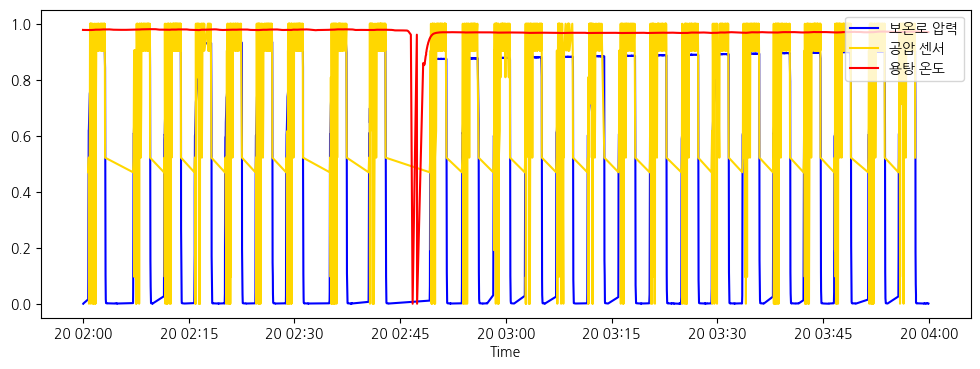

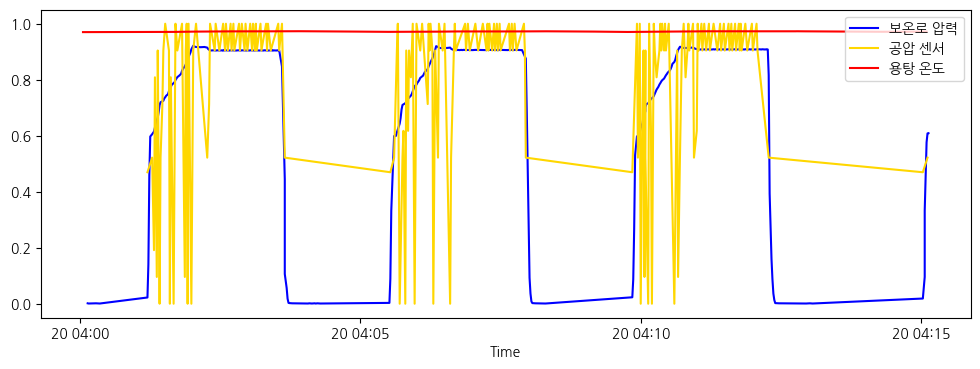

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

In [68]:
dates = FP_df['cnt_time'].dt.date.unique()

# 일별로 + n시간씩 쪼개서 plot
for date in dates:
    time_step = 2 # 몇 시간씩?
    
    for hour in range(0, 24, time_step):
        #start = pd.Timestamp(f'{date} {hour:02d}:00:00')
        #end = pd. Timestamp(f'{date} {hour+4:02d}:00:00')
        
        plt.figure(figsize=(12,4))
        for k, (color, df) in df_dict.items():
            df_by_date = df[df['cnt_time'].dt.date == date]
            #df_by_4h = df_by_date[(df_by_date['cnt_time'] >= start) & (df_by_date['cnt_time'] <= end)]
            df_by_nh = df_by_date[(df_by_date['cnt_time'].dt.hour >= hour) & (df_by_date['cnt_time'].dt.hour < hour + time_step)]
            
            if not df_by_nh.empty:
                plt.plot(df_by_nh['cnt_time'], df_by_nh['cnt_data'], label=k,color=color)
                plt.xlabel('Time')
                plt.legend(loc='upper right')
        plt.show()